### Author- Mithushan Soundararajah 

In [1]:
### importing necessary libraries to build the model
import numpy as np
import pandas as pd
from math import sqrt
from sklearn.preprocessing import LabelEncoder

#plot
import matplotlib.pyplot as plt
import seaborn as sns

# SK learn metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import roc_curve, roc_auc_score, auc
from imblearn.over_sampling import SMOTE 
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedShuffleSplit

#ML models used in the project 
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier

import warnings
warnings.filterwarnings("ignore")

C:\Users\smith\AppData\Local\Temp\ipykernel_10596\1249757315.py:3: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
df=pd.read_csv("final_wine.csv")

In [3]:
df.head(5)

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,type
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,red
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5,red
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5,red
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6,red
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,red


In [4]:
df.shape

(6497, 13)

In [5]:
obj_1_df = df.drop('type',axis=1)

In [6]:
obj_1_df.head(5)


,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


In [7]:
obj_1_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6497 entries, 0 to 6496
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         6497 non-null   float64
 1   volatile acidity      6497 non-null   float64
 2   citric acid           6497 non-null   float64
 3   residual sugar        6497 non-null   float64
 4   chlorides             6497 non-null   float64
 5   free sulfur dioxide   6497 non-null   float64
 6   total sulfur dioxide  6497 non-null   float64
 7   density               6497 non-null   float64
 8   pH                    6497 non-null   float64
 9   sulphates             6497 non-null   float64
 10  alcohol               6497 non-null   float64
 11  quality               6497 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 609.2 KB


In [8]:
#converting the target variable to categorical
obj_1_df['quality']=pd.Categorical(df['quality'])

In [9]:
obj_1_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6497 entries, 0 to 6496
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   fixed acidity         6497 non-null   float64 
 1   volatile acidity      6497 non-null   float64 
 2   citric acid           6497 non-null   float64 
 3   residual sugar        6497 non-null   float64 
 4   chlorides             6497 non-null   float64 
 5   free sulfur dioxide   6497 non-null   float64 
 6   total sulfur dioxide  6497 non-null   float64 
 7   density               6497 non-null   float64 
 8   pH                    6497 non-null   float64 
 9   sulphates             6497 non-null   float64 
 10  alcohol               6497 non-null   float64 
 11  quality               6497 non-null   category
dtypes: category(1), float64(11)
memory usage: 565.2 KB


In [10]:
#reduced the rows due to computational constrain
stratum_colum = 'quality'
stratified_split = StratifiedShuffleSplit(n_splits=1, test_size=1600, random_state=42)
for train_index, test_index in stratified_split.split(obj_1_df, obj_1_df[stratum_colum]):
    wine_ob_1 = obj_1_df.iloc[test_index]


In [11]:
wine_ob_1.reset_index(drop=True, inplace=True)

In [12]:
wine_ob_1

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.1,0.20,0.41,2.1,0.054,24.0,166.0,0.99480,3.48,0.62,10.5,6
1,6.3,0.27,0.18,7.7,0.048,45.0,186.0,0.99620,3.23,0.47,9.0,5
2,6.2,0.25,0.39,1.3,0.051,42.0,135.0,0.99060,3.23,0.40,11.1,6
3,6.8,0.35,0.53,10.1,0.053,37.0,151.0,0.99630,3.07,0.40,9.4,5
4,8.1,0.28,0.49,1.0,0.040,32.0,148.0,0.99360,3.13,0.41,10.0,6
...,...,...,...,...,...,...,...,...,...,...,...,...
1595,7.2,0.23,0.39,14.2,0.058,49.0,192.0,0.99790,2.98,0.48,9.0,7
1596,7.3,0.26,0.33,11.8,0.057,48.0,127.0,0.99693,3.10,0.55,10.0,6
1597,8.5,0.49,0.11,2.3,0.084,9.0,67.0,0.99680,3.17,0.53,9.4,5
1598,7.2,0.20,0.22,1.6,0.044,17.0,101.0,0.99471,3.37,0.53,10.0,5


In [13]:
wine_ob_1.shape

(1600, 12)

In [14]:
wine_ob_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1600 entries, 0 to 1599
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   fixed acidity         1600 non-null   float64 
 1   volatile acidity      1600 non-null   float64 
 2   citric acid           1600 non-null   float64 
 3   residual sugar        1600 non-null   float64 
 4   chlorides             1600 non-null   float64 
 5   free sulfur dioxide   1600 non-null   float64 
 6   total sulfur dioxide  1600 non-null   float64 
 7   density               1600 non-null   float64 
 8   pH                    1600 non-null   float64 
 9   sulphates             1600 non-null   float64 
 10  alcohol               1600 non-null   float64 
 11  quality               1600 non-null   category
dtypes: category(1), float64(11)
memory usage: 139.5 KB


In [15]:
wine_ob_1.isnull().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

In [16]:
#EDA
wine_ob_1.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
count,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000
mean,7.157500,0.336981,0.318969,5.366750,0.055453,30.650312,116.090000,0.994538,3.220569,0.530269,10.534017
std,1.305688,0.160583,0.143146,4.677406,0.035103,18.896042,56.003524,0.002925,0.161866,0.152509,1.204157
min,3.800000,0.080000,0.000000,0.600000,0.014000,1.000000,6.000000,0.987110,2.740000,0.220000,8.000000
25%,6.400000,0.230000,0.250000,1.800000,0.038000,17.000000,77.750000,0.992093,3.110000,0.430000,9.500000
50%,6.900000,0.290000,0.310000,2.950000,0.047000,29.000000,119.000000,0.994610,3.210000,0.500000,10.300000
75%,7.600000,0.400000,0.390000,8.000000,0.062000,41.000000,154.000000,0.996842,3.330000,0.600000,11.400000
max,15.500000,1.130000,1.000000,22.600000,0.610000,289.000000,440.000000,1.003150,3.900000,2.000000,14.000000


In [17]:
pp=sns.pairplot(wine_ob_1,hue='quality', height=10,diag_kind='kde')

In [18]:
#printing out the all the unique featuers in the data set
for column in wine_ob_1:
    unique_vals = np.unique(wine_ob_1[column])
    nr_values = len(unique_vals)
    if nr_values < 10:
        print('The number of values for feature {} :{} -- {}'.
              format(column, 
        nr_values,unique_vals))
    else:
        print('The number of values for feature {} :{}'.
              format(column, nr_values))

The number of values for feature fixed acidity :86
The number of values for feature volatile acidity :134
The number of values for feature citric acid :80
The number of values for feature residual sugar :224
The number of values for feature chlorides :139
The number of values for feature free sulfur dioxide :104
The number of values for feature total sulfur dioxide :241
The number of values for feature density :586
The number of values for feature pH :94
The number of values for feature sulphates :88
The number of values for feature alcohol :76
The number of values for feature quality :7 -- [3 4 5 6 7 8 9]


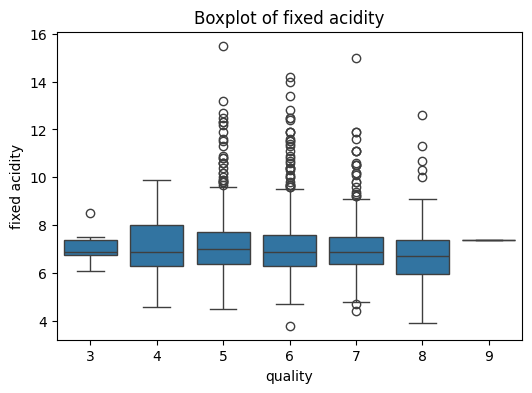

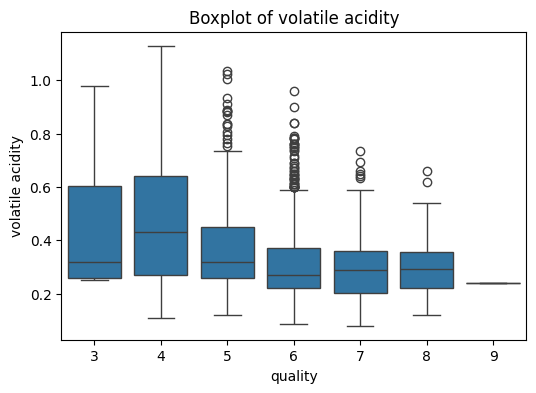

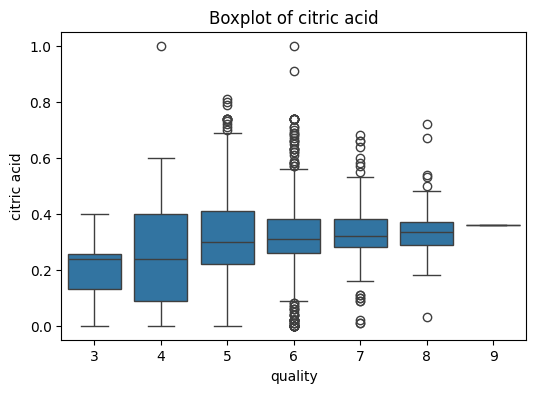

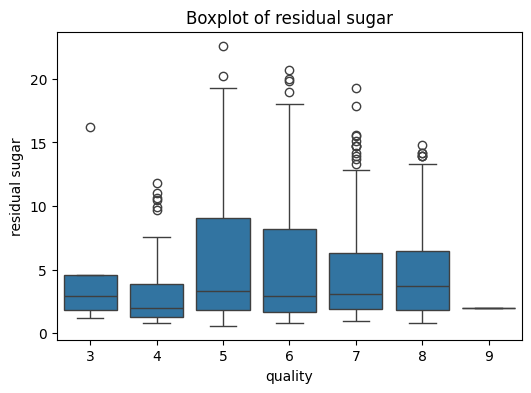

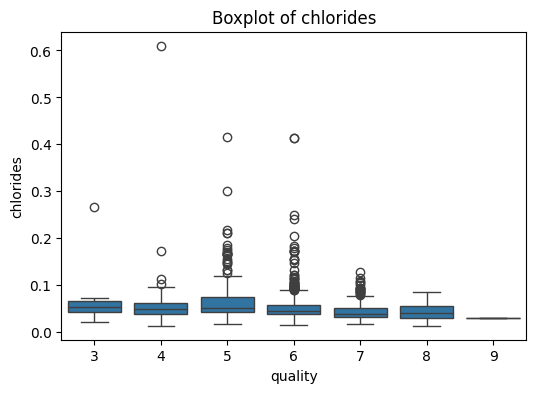

...

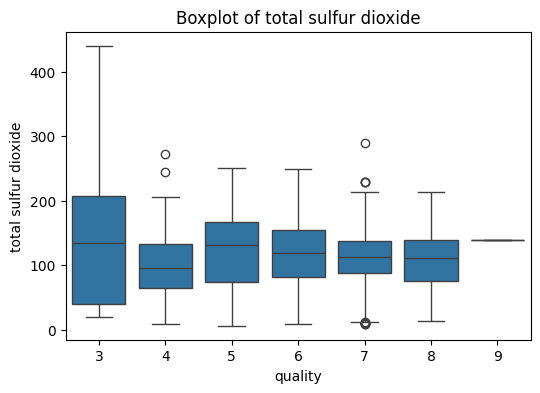

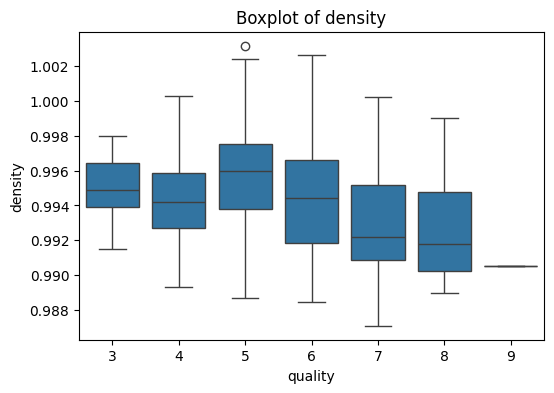

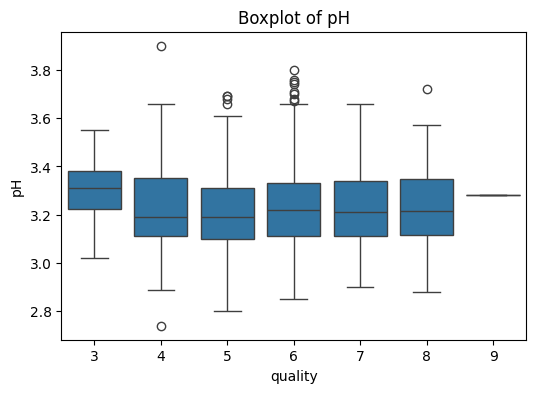

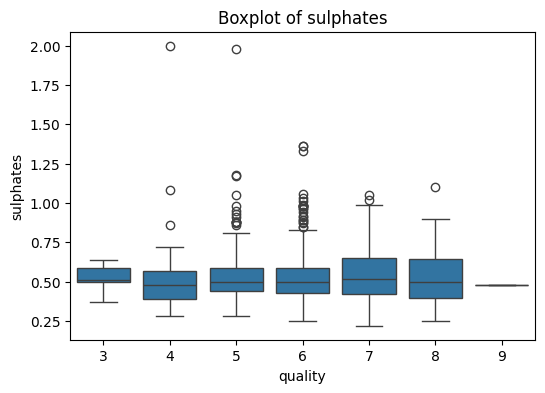

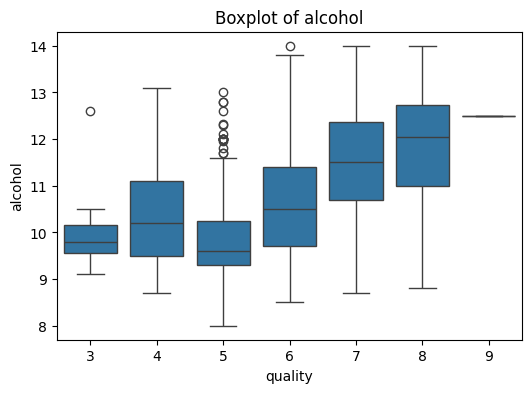

In [19]:
numeircal_columns= ['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides',
                        'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol']
for variable in numeircal_columns:
    plt.figure(figsize=(6,4))
    sns.boxplot(y=variable,x='quality',data=wine_ob_1)
    plt.title(f'Boxplot of {variable}')
    plt.show()

In [20]:
#eliminating the possible outliers using IQR method 
for variable in numeircal_columns:
    Q1 = wine_ob_1[variable].quantile(0.25)
    Q3 = wine_ob_1[variable].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    wine_ob_1 = wine_ob_1[(wine_ob_1[variable] > lower_bound) & (wine_ob_1[variable] < upper_bound)]

In [21]:
wine_ob_1.shape

(1117, 12)

In [22]:
wine_ob_1.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
count,1117.000000,1117.000000,1117.000000,1117.000000,1117.000000,1117.000000,1117.000000,1117.000000,1117.000000,1117.000000,1117.000000
mean,6.843062,0.280980,0.317296,5.992480,0.043765,33.128021,130.521038,0.993881,3.203187,0.488997,10.631791
std,0.799618,0.093897,0.086172,4.858529,0.011828,15.213495,45.611582,0.002825,0.140567,0.104844,1.220277
min,4.700000,0.080000,0.090000,0.600000,0.014000,3.000000,10.000000,0.987110,2.850000,0.220000,8.400000
25%,6.300000,0.220000,0.260000,1.700000,0.036000,22.000000,101.000000,0.991640,3.110000,0.410000,9.500000
50%,6.800000,0.270000,0.310000,4.600000,0.043000,32.000000,130.000000,0.993700,3.200000,0.480000,10.500000
75%,7.300000,0.330000,0.370000,9.000000,0.051000,43.000000,160.000000,0.995960,3.300000,0.550000,11.500000
max,9.300000,0.610000,0.550000,19.300000,0.078000,75.000000,247.000000,1.000380,3.610000,0.780000,13.900000


In [23]:
wine_ob_1['quality'].value_counts()

quality
6    513
5    326
7    216
8     33
4     25
3      3
9      1
Name: count, dtype: int64

In [24]:
mask = wine_ob_1['quality'] == 9
wine_filt= wine_ob_1[~mask].reset_index(drop=True)

In [25]:
wine_filt['quality'].value_counts()

quality
6    513
5    326
7    216
8     33
4     25
3      3
9      0
Name: count, dtype: int64

In [26]:
#printing out the all the unique featuers in the data set
for column in wine_filt:
    unique_vals = np.unique(wine_filt[column])
    nr_values = len(unique_vals)
    if nr_values < 10:
        print('The number of values for feature {} :{} -- {}'.
              format(column, 
        nr_values,unique_vals))
    else:
        print('The number of values for feature {} :{}'.
              format(column, nr_values))

The number of values for feature fixed acidity :45
The number of values for feature volatile acidity :73
The number of values for feature citric acid :46
The number of values for feature residual sugar :208
The number of values for feature chlorides :65
The number of values for feature free sulfur dioxide :84
The number of values for feature total sulfur dioxide :215
The number of values for feature density :474
The number of values for feature pH :77
The number of values for feature sulphates :54
The number of values for feature alcohol :68
The number of values for feature quality :6 -- [3 4 5 6 7 8]


### SMOTE for data imbalance

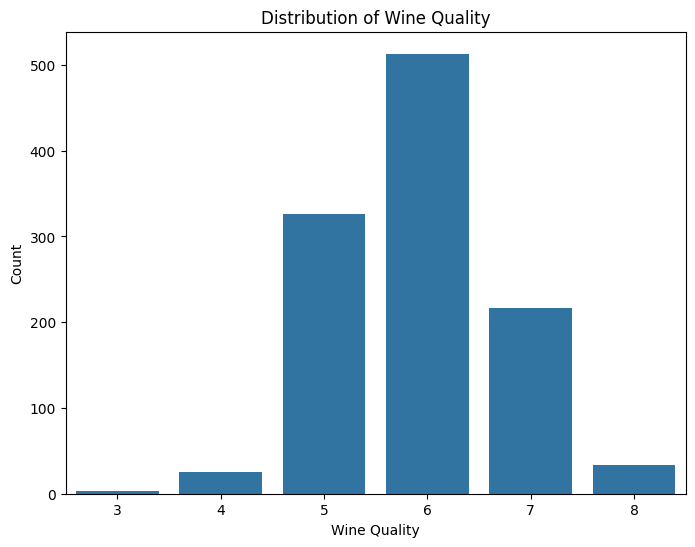

In [27]:
plt.figure(figsize=(8, 6))
sns.countplot(x='quality', data=wine_filt, order=sorted(wine_filt['quality'].unique()))
plt.xlabel('Wine Quality')
plt.ylabel('Count')
plt.title('Distribution of Wine Quality')
plt.show()

In [28]:
x=wine_filt.drop('quality',axis=1)
y=wine_filt['quality']

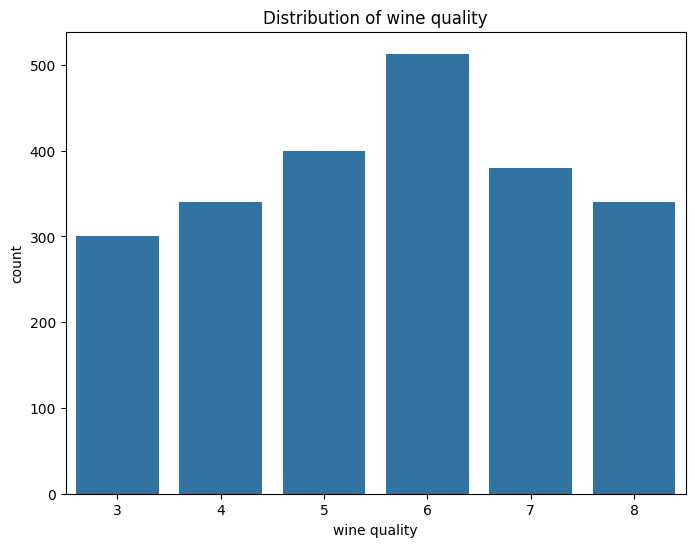

In [29]:
sample_strat={5:400,7:380,4:340,8:340,3:300}
oversample=SMOTE(sampling_strategy=sample_strat,k_neighbors=2,random_state=32)
x,y=oversample.fit_resample(x,y)
plt.figure(figsize=(8,6))
sns.countplot(x=y,order=sorted(wine_filt['quality'].unique()))
plt.xlabel('wine quality')
plt.ylabel('count')
plt.title('Distribution of wine quality')
plt.show()

In [30]:
y.value_counts()

quality
6    513
5    400
7    380
4    340
8    340
3    300
9      0
Name: count, dtype: int64

In [31]:
#train test split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2,random_state=32)

In [32]:
%%time
clf=GridSearchCV(svm.SVC(gamma='auto',decision_function_shape='ovr'),{
    'C':[1,10,100],
    'kernel':['rbf','sigmoid'],
    'class_weight':[None,'balanced']
    },cv=5,return_train_score=False)
clf.fit(x_train,y_train)
print(clf.best_params_)
print(clf.best_score_)

{'C': 100, 'class_weight': None, 'kernel': 'rbf'}
0.7326839826839827
CPU times: total: 6.27 s
Wall time: 10.8 s


In [33]:
%%time
lrhp=GridSearchCV(LogisticRegression(multi_class='multinomial'),{
    'C':[1,10,20],
    'fit_intercept':[True,False],
    'class_weight':[None,'balanced'],
    'solver':['lbfgs','sag','saga'],
    'max_iter':[200,1000]
},cv=5,return_train_score=False)
lrhp.fit(x_train,y_train)
print(lrhp.best_params_)
print(lrhp.best_score_)

{'C': 10, 'class_weight': None, 'fit_intercept': True, 'max_iter': 1000, 'solver': 'lbfgs'}
0.4587563951200315
CPU times: total: 55 s
Wall time: 2min 13s


In [34]:
%%time
rfchp=GridSearchCV(RandomForestClassifier(),{
    'n_estimators':[50,100,200],
    'criterion':['gini','entrophy'],
    'max_depth':[20,30],
    'min_samples_split':[2,5],
    'min_samples_leaf':[1,2],
    'class_weight':[None,'balanced']
},cv=5,return_train_score=False)
rfchp.fit(x_train,y_train)
print(rfchp.best_params_)
print(rfchp.best_score_)

{'class_weight': None, 'criterion': 'gini', 'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
0.7755804801259346
CPU times: total: 51 s
Wall time: 2min 3s


In [35]:
#scaled the data to support the KNN classifier (it works well with classified data)
scaler=MinMaxScaler()
x_train_scale=scaler.fit_transform(x_train)
x_test_scale=scaler.transform(x_test)

In [36]:
%%time
KNNhp=GridSearchCV(KNeighborsClassifier(),{
    'n_neighbors':[3,5,7],
    'weights':['uniform','distance'],
    'algorithm':['ball-tree','kd-tree','brute'],
    'metric':['eucliean','manhatton','chebyshev','humming']
},cv=5,return_train_score=False)
KNNhp.fit(x_train,y_train)
print(KNNhp.best_params_)
print(KNNhp.best_score_)

{'algorithm': 'brute', 'metric': 'chebyshev', 'n_neighbors': 3, 'weights': 'distance'}
0.6677852450579724
CPU times: total: 2.02 s
Wall time: 1.16 s


### phase 1 - with all featuers training 
### Table with scores and best performing parameter

In [37]:
model_params = {
    'svm': {
        'model': svm.SVC(gamma='auto'),
        'params' : {
            'C': [10],
            'kernel': ['rbf'],
            'class_weight':[None]
        }  
    },
    'random_forest': {
        'model': RandomForestClassifier(),
        'params' : {
            'n_estimators': [200],
            'criterion':['gini'],
            'max_depth':[30],
            'min_samples_leaf':[1],
            'min_samples_split':[2],
            
        }
    },
    'logistic_regression' : {
        'model': LogisticRegression(multi_class='multinomial'),
        'params': {
            'C': [10],
            'class_weight':[None],
            'fit_intercept':[False],
            'max_iter':[1000],
            'solver':['lbfgs']
            
        }
    },
    'k nearest neighbors classifier':{
        'model':KNeighborsClassifier(),
        'params':{
            'algorithm':['brute'],
            'metric':['chebyshev'],
            'n_neighbors':[3],
            'weights':['distance']
        }
    }
}
scores=[]
for model_name, mp in model_params.items():
    clff=GridSearchCV(mp['model'],mp['params'],cv=5,return_train_score=False)
    clff.fit(x_train,y_train)
    scores.append({
        'model':model_name,
        'best_score':clff.best_score_,
        'best_params':clff.best_params_
    })

final_table=pd.DataFrame(scores,columns=['model','best_score','best_params'])
final_table

,model,best_score,best_params
0,svm,0.729935,"{'C': 10, 'class_weight': None, 'kernel': 'rbf'}"
1,random_forest,0.767339,"{'criterion': 'gini', 'max_depth': 30, 'min_sa..."
2,logistic_regression,0.453244,"{'C': 10, 'class_weight': None, 'fit_intercept..."
3,k nearest neighbors classifier,0.667785,"{'algorithm': 'brute', 'metric': 'chebyshev', ..."


### Random Forest Classifier model evaluation

In [38]:
from sklearn.multiclass import OneVsRestClassifier
from sklearn.preprocessing import label_binarize
best_params = {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 2, 'min_samples_leaf': 1, 'n_estimators': 100}
final_model_rfc = OneVsRestClassifier(RandomForestClassifier(**best_params))
final_model_rfc.fit(x_train,y_train)
final_ypred=final_model_rfc.predict(x_test)
pred_prob=final_model_rfc.predict_proba(x_test)

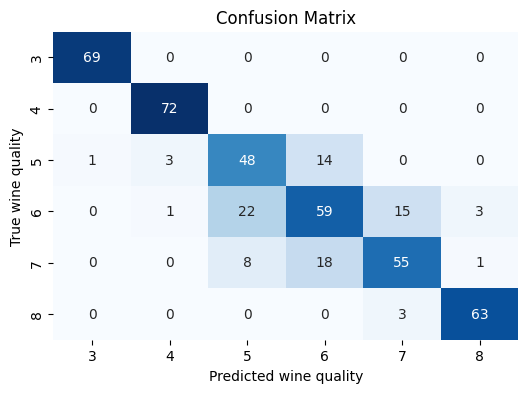

In [39]:
conf_matrix = confusion_matrix(y_test, final_ypred)
plt.figure(figsize=(6, 4))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=np.unique(y_test), yticklabels=np.unique(y_test))
plt.xlabel('Predicted wine quality')
plt.ylabel('True wine quality')
plt.title('Confusion Matrix')
plt.show()

In [40]:
wine_class_report = classification_report(y_test, final_ypred)
print(wine_class_report)

              precision    recall  f1-score   support

           3       0.99      1.00      0.99        69
           4       0.95      1.00      0.97        72
           5       0.62      0.73      0.67        66
           6       0.65      0.59      0.62       100
           7       0.75      0.67      0.71        82
           8       0.94      0.95      0.95        66

    accuracy                           0.80       455
   macro avg       0.82      0.82      0.82       455
weighted avg       0.80      0.80      0.80       455



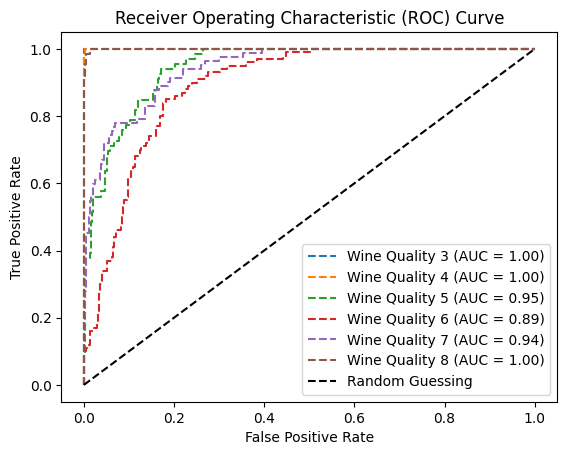

In [41]:
y_test_binarized = label_binarize(y_test, classes=np.unique(y_test))

fpr = {}
tpr = {}
thresh = {}
roc_auc = {}

n_class = y_test_binarized.shape[1]

# Plot ROC curve for each class
for i in range(n_class):
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test_binarized[:, i], pred_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
    
    plt.plot(fpr[i], tpr[i], linestyle='--', label=f'Wine Quality {np.unique(y_test)[i]} (AUC = {roc_auc[i]:.2f})')

# Plot the random guessing line
plt.plot([0, 1], [0, 1], linestyle='--', color='black', label='Random Guessing')

# Set labels and title
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

### saving the wine quality prediction (Multiclass) Model 

In [42]:
import joblib

In [43]:
joblib.dump(final_model_rfc,'RFC_wine_quality_model.pkl')

['RFC_wine_quality_model.pkl']

## Section break - New objective and New model 

## ML model for wine type (red and white) prediction (Binary classification)

In [44]:
ob_2_df=df.drop('quality',axis=1)

In [45]:
ob_2_df

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,type
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,red
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,red
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,red
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8,red
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,red
...,...,...,...,...,...,...,...,...,...,...,...,...
6492,6.2,0.21,0.29,1.6,0.039,24.0,92.0,0.99114,3.27,0.50,11.2,white
6493,6.6,0.32,0.36,8.0,0.047,57.0,168.0,0.99490,3.15,0.46,9.6,white
6494,6.5,0.24,0.19,1.2,0.041,30.0,111.0,0.99254,2.99,0.46,9.4,white
6495,5.5,0.29,0.30,1.1,0.022,20.0,110.0,0.98869,3.34,0.38,12.8,white


In [46]:
ob_2_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6497 entries, 0 to 6496
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         6497 non-null   float64
 1   volatile acidity      6497 non-null   float64
 2   citric acid           6497 non-null   float64
 3   residual sugar        6497 non-null   float64
 4   chlorides             6497 non-null   float64
 5   free sulfur dioxide   6497 non-null   float64
 6   total sulfur dioxide  6497 non-null   float64
 7   density               6497 non-null   float64
 8   pH                    6497 non-null   float64
 9   sulphates             6497 non-null   float64
 10  alcohol               6497 non-null   float64
 11  type                  6497 non-null   object 
dtypes: float64(11), object(1)
memory usage: 609.2+ KB


In [47]:
ob_2_df['type']=pd.Categorical(ob_2_df['type'])

In [48]:
ob_2_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6497 entries, 0 to 6496
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype   
---  ------                --------------  -----   
 0   fixed acidity         6497 non-null   float64 
 1   volatile acidity      6497 non-null   float64 
 2   citric acid           6497 non-null   float64 
 3   residual sugar        6497 non-null   float64 
 4   chlorides             6497 non-null   float64 
 5   free sulfur dioxide   6497 non-null   float64 
 6   total sulfur dioxide  6497 non-null   float64 
 7   density               6497 non-null   float64 
 8   pH                    6497 non-null   float64 
 9   sulphates             6497 non-null   float64 
 10  alcohol               6497 non-null   float64 
 11  type                  6497 non-null   category
dtypes: category(1), float64(11)
memory usage: 564.9 KB


In [49]:
#reduced the rows due to computational constrain
stratum_colum = 'type'
stratified_split = StratifiedShuffleSplit(n_splits=1, test_size=1600, random_state=42)
for train_index, test_index in stratified_split.split(ob_2_df, ob_2_df[stratum_colum]):
    wine_ob_2 = ob_2_df.iloc[test_index]

In [50]:
wine_ob_2.reset_index(drop=True, inplace=True)
wine_ob_2

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,type
0,7.8,0.240,0.38,2.10,0.058,14.0,167.0,0.99400,3.21,0.55,9.9,white
1,7.0,0.360,0.32,10.05,0.045,37.0,131.0,0.99352,3.09,0.33,11.7,white
2,7.3,0.205,0.31,1.70,0.060,34.0,110.0,0.99630,3.72,0.69,10.5,white
3,8.0,0.450,0.36,8.80,0.026,50.0,151.0,0.99270,3.07,0.25,12.7,white
4,6.4,0.290,0.20,15.60,0.040,20.0,142.0,0.99620,3.10,0.54,10.6,white
...,...,...,...,...,...,...,...,...,...,...,...,...
1595,5.8,0.280,0.30,1.50,0.026,31.0,114.0,0.98952,3.32,0.60,12.5,white
1596,9.5,0.370,0.52,2.00,0.082,6.0,26.0,0.99800,3.18,0.51,9.5,red
1597,6.8,0.240,0.35,6.40,0.048,44.0,172.0,0.99440,3.29,0.55,10.5,white
1598,7.4,0.260,0.32,3.70,0.032,29.0,193.0,0.99134,3.10,0.67,12.5,white


In [51]:
wine_ob_2.shape

(1600, 12)

In [52]:
wine_ob_2.isnull().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
type                    0
dtype: int64

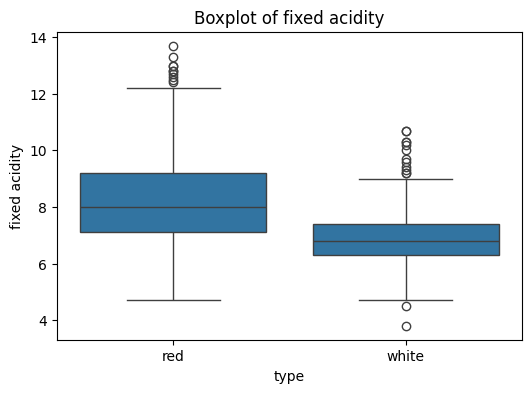

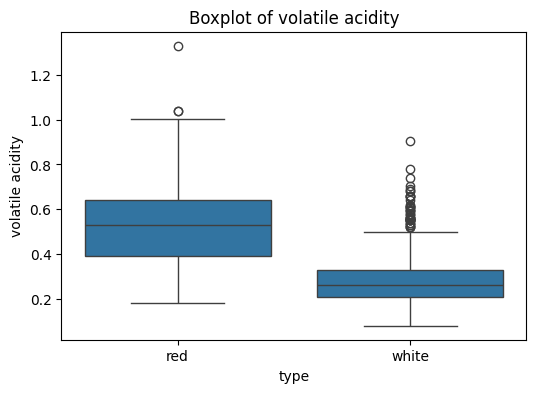

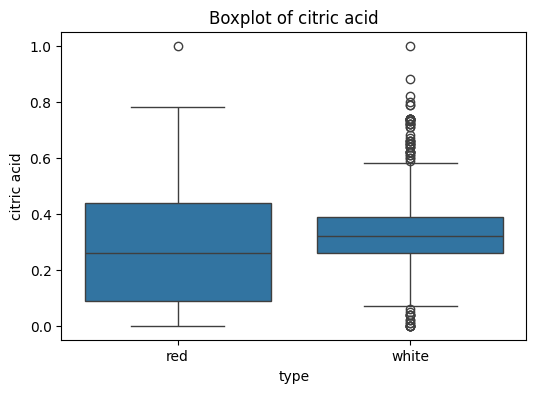

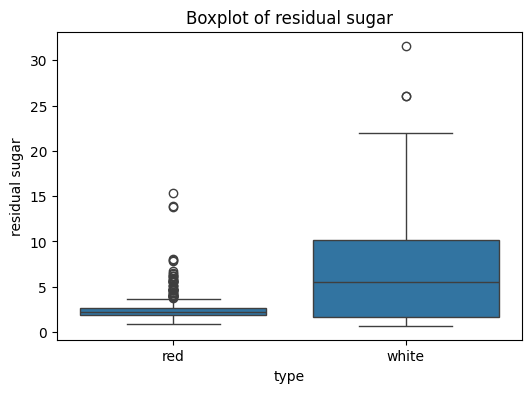

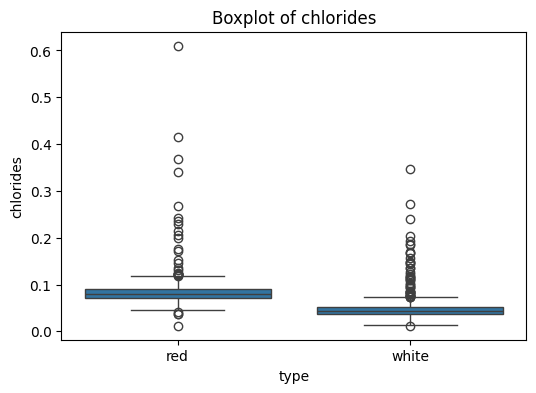

...

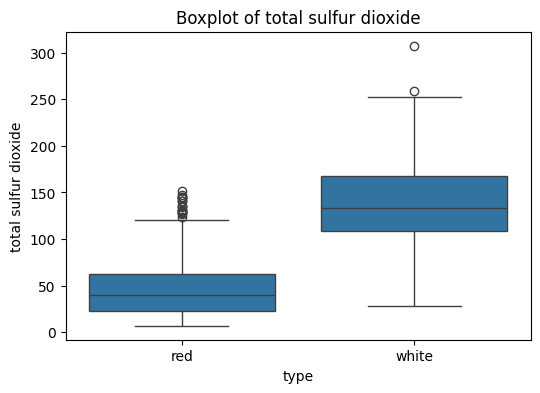

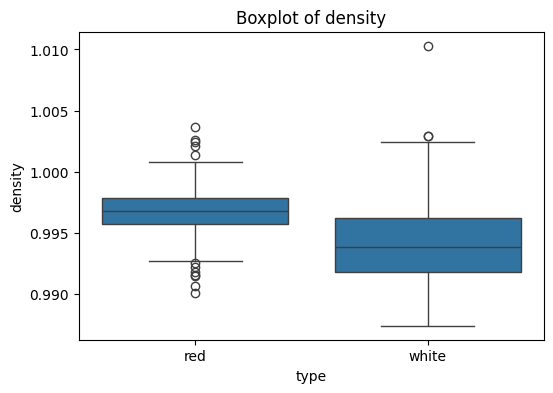

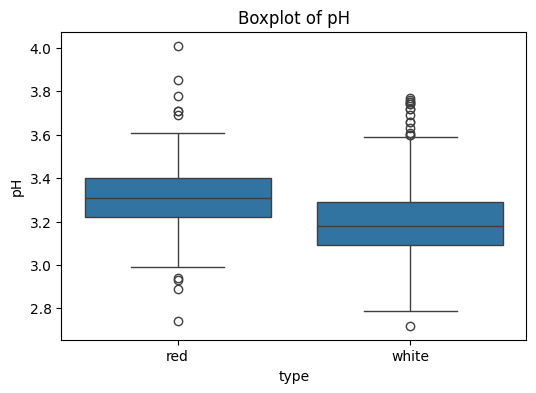

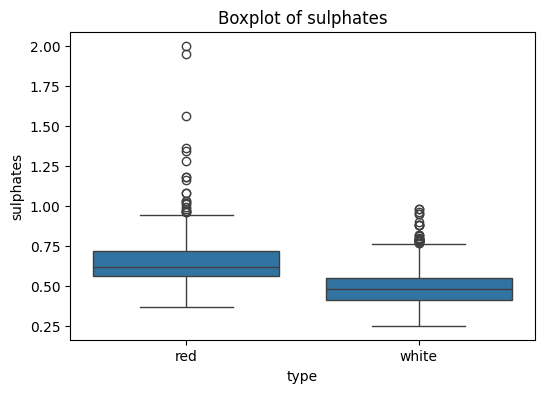

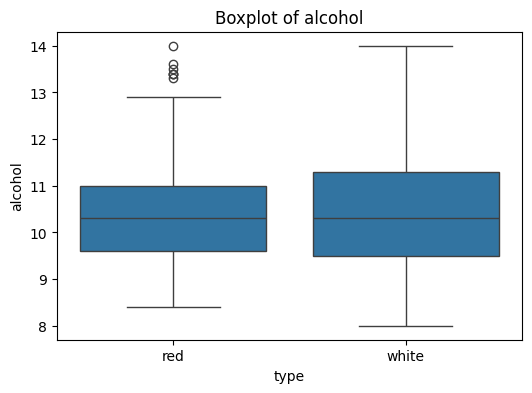

In [53]:
numeircal_columns= ['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides',
                        'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol']
for variable in numeircal_columns:
    plt.figure(figsize=(6,4))
    sns.boxplot(y=variable,x='type',data=wine_ob_2)
    plt.title(f'Boxplot of {variable}')
    plt.show()

In [54]:
#eliminating the possible outliers using IQR method 
for variable in numeircal_columns:
    Q1 = wine_ob_2[variable].quantile(0.25)
    Q3 = wine_ob_2[variable].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    wine_ob_2 = wine_ob_2[(wine_ob_2[variable] > lower_bound) & (wine_ob_2[variable] < upper_bound)]

In [55]:
wine_ob_2.shape

(1162, 12)

In [56]:
wine_ob_2['type'].value_counts()

type
white    1049
red       113
Name: count, dtype: int64

In [57]:
label_encoder = LabelEncoder()
# Fit and transform the 'wine_quality' column
wine_ob_2['type'] = label_encoder.fit_transform(wine_ob_2['type'])
label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
print(label_mapping)

{'red': 0, 'white': 1}


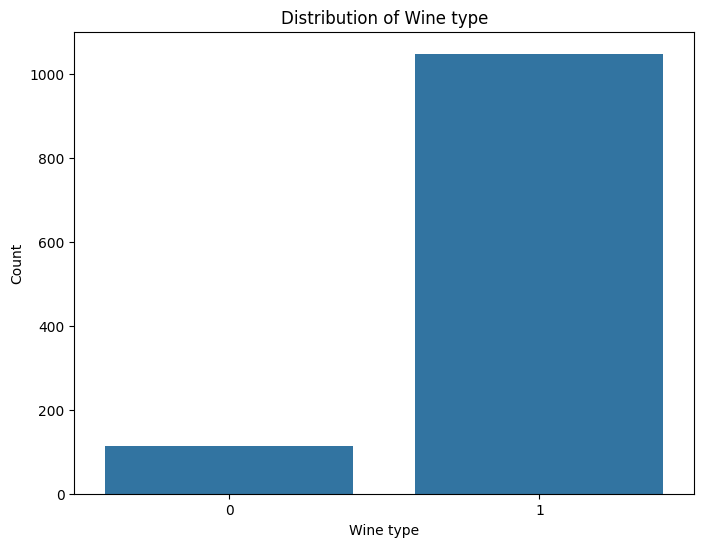

In [58]:
plt.figure(figsize=(8, 6))
sns.countplot(x='type', data=wine_ob_2)
plt.xlabel('Wine type')
plt.ylabel('Count')
plt.title('Distribution of Wine type')
plt.show()

In [59]:
x_ob_2=wine_ob_2.drop('type',axis=1)
y_ob_2=wine_ob_2['type']

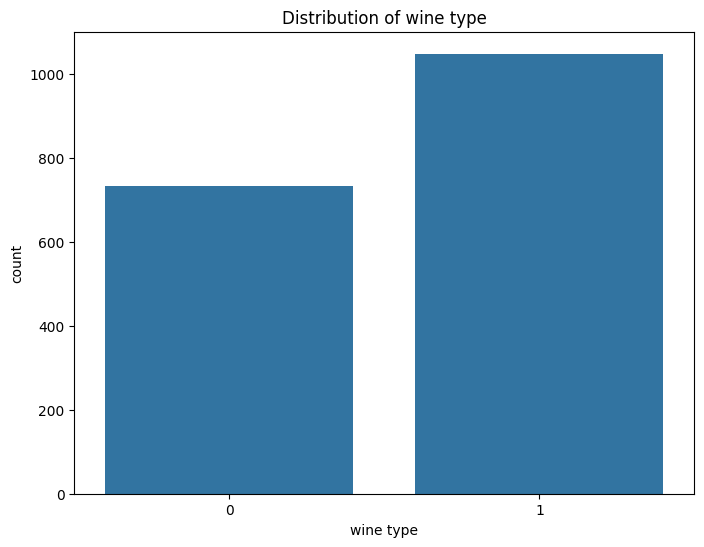

In [60]:
oversample=SMOTE(sampling_strategy=0.7, k_neighbors=50, random_state=32)  # Increased sampling_strategy
x,y=oversample.fit_resample(x_ob_2,y_ob_2)
plt.figure(figsize=(8,6))
sns.countplot(x=y,order=sorted(wine_ob_2['type'].unique()))
plt.xlabel('wine type')
plt.ylabel('count')
plt.title('Distribution of wine type')
plt.show()

In [61]:
y.value_counts()

type
1    1049
0     734
Name: count, dtype: int64

In [62]:
x_train_ob_2, x_test_ob_2, y_train_ob_2, y_test_ob_2 = train_test_split(x, y, test_size=0.2,random_state=32)

In [63]:
%%time
clf=GridSearchCV(svm.SVC(gamma='auto'),{
    'C':[1,10,100],
    'kernel':['rbf','sigmoid','linear'],
    'class_weight':[None,'balanced']
    },cv=5,return_train_score=False)
clf.fit(x_train_ob_2,y_train_ob_2)
print(clf.best_params_)
print(clf.best_score_)

{'C': 100, 'class_weight': None, 'kernel': 'linear'}
0.9894736842105264
CPU times: total: 28.9 s
Wall time: 1min 15s


In [64]:
%%time
lrhp=GridSearchCV(LogisticRegression(multi_class='auto'),{
    'C':[1,10,20],
    'fit_intercept':[True,False],
    'class_weight':[None,'balanced'],
    'solver':['lbfgs','sag','saga','liblinear'],
    'max_iter':[200,1000]
},cv=5,return_train_score=False)
lrhp.fit(x_train_ob_2,y_train_ob_2)
print(lrhp.best_params_)
print(lrhp.best_score_)

{'C': 20, 'class_weight': None, 'fit_intercept': True, 'max_iter': 1000, 'solver': 'lbfgs'}
0.9845687645687645
CPU times: total: 10.3 s
Wall time: 54.7 s


In [65]:
%%time
rfchp=GridSearchCV(RandomForestClassifier(),{
    'n_estimators':[50,100,200],
    'criterion':['gini','entrophy'],
    'max_depth':[5,20,30],
    'min_samples_split':[2,5,10],
    'min_samples_leaf':[1,2,5],
    'class_weight':[None,'balanced']
},cv=5,return_train_score=False)
rfchp.fit(x_train_ob_2,y_train_ob_2)
print(rfchp.best_params_)
print(rfchp.best_score_)

{'class_weight': None, 'criterion': 'gini', 'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
0.992984909827015
CPU times: total: 1min 12s
Wall time: 3min 37s


In [66]:
%%time
KNNhp=GridSearchCV(KNeighborsClassifier(),{
    'n_neighbors':[3,5,7],
    'weights':['uniform','distance'],
    'algorithm':['ball-tree','kd-tree','brute'],
    'metric':['eucliean','manhatton','chebyshev','humming']
},cv=5,return_train_score=False)
KNNhp.fit(x_train_ob_2,y_train_ob_2)
print(KNNhp.best_params_)
print(KNNhp.best_score_)

{'algorithm': 'brute', 'metric': 'chebyshev', 'n_neighbors': 7, 'weights': 'distance'}
0.8948276285118391
CPU times: total: 1.88 s
Wall time: 1.24 s


In [67]:
model_params = {
    'svm': {
        'model': svm.SVC(gamma='auto'),
        'params' : {
            'C': [100],
            'kernel': ['linear'],
            'class_weight':[None]
        }  
    },
    'random_forest': {
        'model': RandomForestClassifier(),
        'params' : {
            'n_estimators': [50],
            'criterion':['gini'],
            'max_depth':[5],
            'min_samples_leaf':[1],
            'min_samples_split':[5],
            'class_weight':[None]
            
        }
    },
    'logistic_regression' : {
        'model': LogisticRegression(),
        'params': {
            'C': [20],
            'class_weight':[None],
            'fit_intercept':[True],
            'max_iter':[1000],
            'solver':['lbfgs']
            
        }
    },
    'k nearest neighbors classifier':{
        'model':KNeighborsClassifier(),
        'params':{
            'algorithm':['brute'],
            'metric':['chebyshev'],
            'n_neighbors':[7],
            'weights':['distance']
        }
    }
}
scores=[]
for model_name, mp in model_params.items():
    clff_ob_2=GridSearchCV(mp['model'],mp['params'],cv=5,return_train_score=False)
    clff_ob_2.fit(x_train_ob_2,y_train_ob_2)
    scores.append({
        'model':model_name,
        'best_score':clff_ob_2.best_score_,
        'best_params':clff_ob_2.best_params_
    })

final_table=pd.DataFrame(scores,columns=['model','best_score','best_params'])
final_table

,model,best_score,best_params
0,svm,0.989474,"{'C': 100, 'class_weight': None, 'kernel': 'li..."
1,random_forest,0.990183,"{'class_weight': None, 'criterion': 'gini', 'm..."
2,logistic_regression,0.984569,"{'C': 20, 'class_weight': None, 'fit_intercept..."
3,k nearest neighbors classifier,0.894828,"{'algorithm': 'brute', 'metric': 'chebyshev', ..."


In [68]:
best_params = {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 5, 'min_samples_leaf': 2, 'n_estimators': 50,
               'class_weight':None}
fm_binary_model = OneVsRestClassifier(RandomForestClassifier(**best_params))
fm_binary_model.fit(x_train_ob_2,y_train_ob_2)
final_ypred_binary=fm_binary_model.predict(x_test_ob_2)

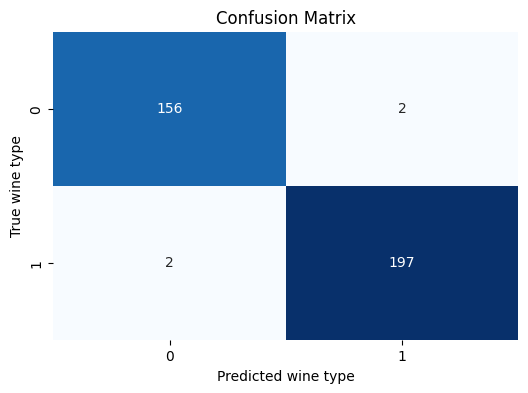

In [69]:
conf_matrix_binary = confusion_matrix(y_test_ob_2, final_ypred_binary)
plt.figure(figsize=(6, 4))
sns.heatmap(conf_matrix_binary, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=np.unique(y_test_ob_2), yticklabels=np.unique(y_test_ob_2))
plt.xlabel('Predicted wine type')
plt.ylabel('True wine type')
plt.title('Confusion Matrix')
plt.show()

In [70]:
wine_class_report_binary = classification_report(y_test_ob_2, final_ypred_binary)
print(wine_class_report_binary)

              precision    recall  f1-score   support

           0       0.99      0.99      0.99       158
           1       0.99      0.99      0.99       199

    accuracy                           0.99       357
   macro avg       0.99      0.99      0.99       357
weighted avg       0.99      0.99      0.99       357



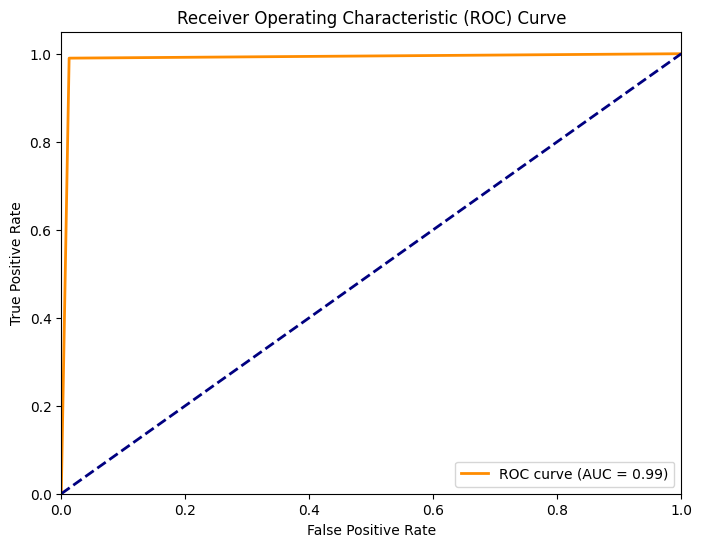

In [71]:
fpr, tpr, thresholds = roc_curve(y_test_ob_2, final_ypred_binary)
roc_auc = roc_auc_score(y_test_ob_2, final_ypred_binary)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()

### saving the Wine type (Binary classification model) to a pickle file

In [72]:
joblib.dump(fm_binary_model,'RFC_wine_type_binary_model.pkl')

['RFC_wine_type_binary_model.pkl']